# Detecting Invasive Species

### A Deep Learning Competition from Kaggle

Description from https://www.kaggle.com/c/invasive-species-monitoring:

Tangles of kudzu overwhelm trees in Georgia while cane toads threaten habitats in over a dozen countries worldwide. These are just two invasive species of many which can have damaging effects on the environment, the economy, and even human health. Despite widespread impact, efforts to track the location and spread of invasive species are so costly that they’re difficult to undertake at scale.

Currently, ecosystem and plant distribution monitoring depends on expert knowledge. Trained scientists visit designated areas and take note of the species inhabiting them. Using such a highly qualified workforce is expensive, time inefficient, and insufficient since humans cannot cover large areas when sampling.

Because scientists cannot sample a large quantity of areas, some machine learning algorithms are used in order to predict the presence or absence of invasive species in areas that have not been sampled. The accuracy of this approach is far from optimal, but still contributes to approaches to solving ecological problems.

In this playground competition, Kagglers are challenged to develop algorithms to more accurately identify whether images of forests and foliage contain invasive hydrangea or not. Techniques from computer vision alongside other current technologies like aerial imaging can make invasive species monitoring cheaper, faster, and more reliable.

Description of Data:

The data set contains pictures taken in a Brazilian national forest. In some of the pictures there is Hydrangea, a beautiful invasive species original of Asia. Based on the training pictures and the labels provided, the participant should predict the presence of the invasive species in the testing set of pictures.

## 1.  Exploritory Data Analysis


In [106]:
# Load relevant libraries
import numpy as np
import pandas as pd
import seaborn as sns
from IPython.display import Image
import matplotlib.pyplot as plt
%matplotlib inline
from keras.layers import Convolution2D
from keras.layers import MaxPooling2D
from keras.models import Sequential, Model, load_model
from keras import applications
from keras import optimizers
from keras.layers import Dropout, Flatten, Dense
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint
from tensorflow.python.keras.applications import ResNet50
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dense, Flatten, GlobalAveragePooling2D
from IPython.display import display

Let's load the images labels from the training data and plot how many of the images are invasive vs. how many are non-invasive.

In [148]:
# Doenload train data labels.
labels = pd.read_csv('train_labels.csv')
print (labels['invasive'].value_counts())

1    1448
0     847
Name: invasive, dtype: int64


Text(0,0.5,'Count')

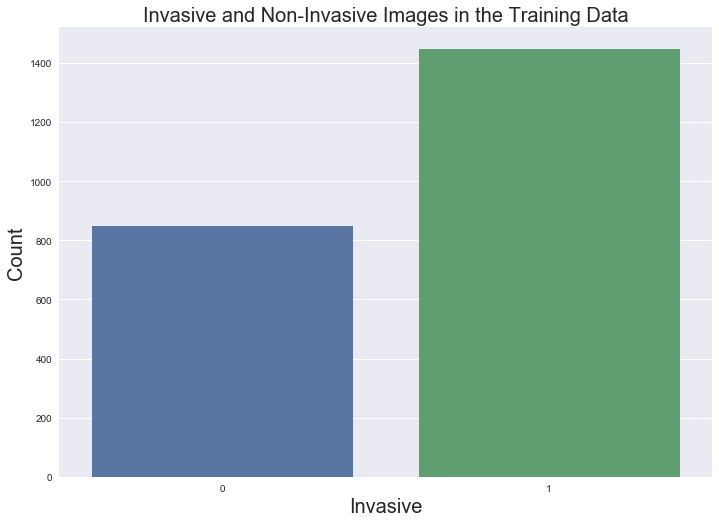

In [174]:
sns.set(style='darkgrid')
ax = sns.countplot(x = 'invasive', data = labels)
plt.title('Invasive and Non-Invasive Images in the Training Data', fontsize = 20)
plt.xlabel('Invasive', fontsize = 20)
plt.ylabel('Count', fontsize = 20)

## 2. Image Preparation

Because we're only working with 2295 training photos, which is actually not very many for proper training of a model, we need to use image augmentation to make sure the model doesn't overfit to the training data, and hopfull give it a better chance of detecting relevant features from the images. I chose to use the Keras function "FlowFromDirectory" to perform image augmentation and to feed images into the Convolutional Neaural Networks. In order to use this function, images must be organized in a specific way. The first step is to create 4 text files with the proper image labels.

In [4]:
# This code is borrowed from this very helpful kernel: https://www.kaggle.com/ievgenvp/keras-flow-from-directory-on-python
classes = [0,1]

for i in classes:
    df_class = labels.loc[labels['invasive'] == i]
    df_class = df_class['name'].astype(str)+'.jpg'
    n = lambda x: 100 if i == 1 else 37
    validation_pack = np.random.choice(df_class.values, n(i), replace = False)
    np.savetxt('class_{0}_val.txt'.format(i), validation_pack, fmt = '%s')

    training_pack = np.setdiff1d(df_class.values, validation_pack)
    np.savetxt('class_{0}_tr.txt'.format(i), training_pack, fmt = '%s')

In [114]:
import shutil
import os

#Read text files that were created above.
tr_0 = pd.read_csv('class_0_tr.txt', header = None)
tr_1 = pd.read_csv('class_1_tr.txt', header = None)
val_0 = pd.read_csv('class_0_val.txt', header = None)
val_1 = pd.read_csv('class_1_val.txt', header = None)

# I created new folders on my computer to store the images properly.
source = '/Users/sauce/Desktop/Data/train' # This path contians all images in the training set.
dest1 = '/Users/sauce/Desktop/Data/train/class_0_tr' # Folder for all non-invasive images for training.
dest2 = '/Users/sauce/Desktop/Data/train/class_1_tr' # Folder for all invasive images for training.
dest3 = '/Users/sauce/Desktop/Data/train/class_0_val' # Folder for all non-invasive images for validation.
dest4 = '/Users/sauce/Desktop/Data/train/class_1_val' # Folder for all invasive images for validation.

# Create empty lists for each folder.
tr0_list = []
tr1_list = []
val0_list = []
val1_list = []

# Take all of binary values from each text file created above.
tr_0 = tr_0[0]
tr_1 = tr_1[0]
val_0 = val_0[0]
val_1 = val_1[0]

# Append values to new lists.
for i in tr_0:
    tr0_list.append(i)
for i in tr_1:
    tr1_list.append(i)
for i in val_0:
    val0_list.append(i)
for i in val_1:
    val1_list.append(i)


# Create variable called files that includes all training images.
files = os.listdir(source)

# Move images to respective folder.
for i in files:
    if i in tr0_list:
        shutil.move(i, dest1)
    elif i in tr1_list:
        shutil.move(i, dest2)
    elif i in val0_list:
        shutil.move(i, dest3)
    elif i in val1_list:
        shutil.move(i, dest4)

In [127]:
non_invasive_train = os.listdir(dest1)
invasive_train = os.listdir(dest2)
non_invasive_val = os.listdir(dest3)
invasive_val = os.listdir(dest4)

print("There are now", len(non_invasive_train), "images that in the folder containing non-invasive images for training.")
print("There are", len(invasive_train), "images that in the folder containing invasive images for training.")
print("There are", len(non_invasive_val), "images that in the folder contianing non-invasive photos for validation.")
print("There are", len(invasive_val), "images that in the folder containing invasive photos for validation.")

There are now 811 images that in the folder containing non-invasive images for training.
There are 1348 images that in the folder containing invasive images for training.
There are 37 images that in the folder contianing non-invasive photos for validation.
There are 100 images that in the folder containing invasive photos for validation.


In [133]:
print('There are', len(non_invasive_train)+len(invasive_train), 'images in the training dataset.')
print('There are', len(non_invasive_val)+len(invasive_val), 'images in the validation dataset.')

There are 2159 images in the training dataset.
There are 137 images in the validation dataset.


Below is a screenshot of how my images are organized into seperate folders.

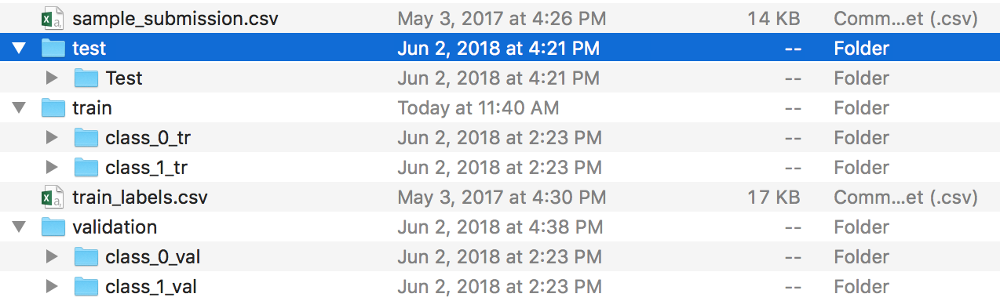

In [105]:
Image(filename= 'folders.png')

## 3. Display Images

Let's look at a couple images that include invasive hydrangea.

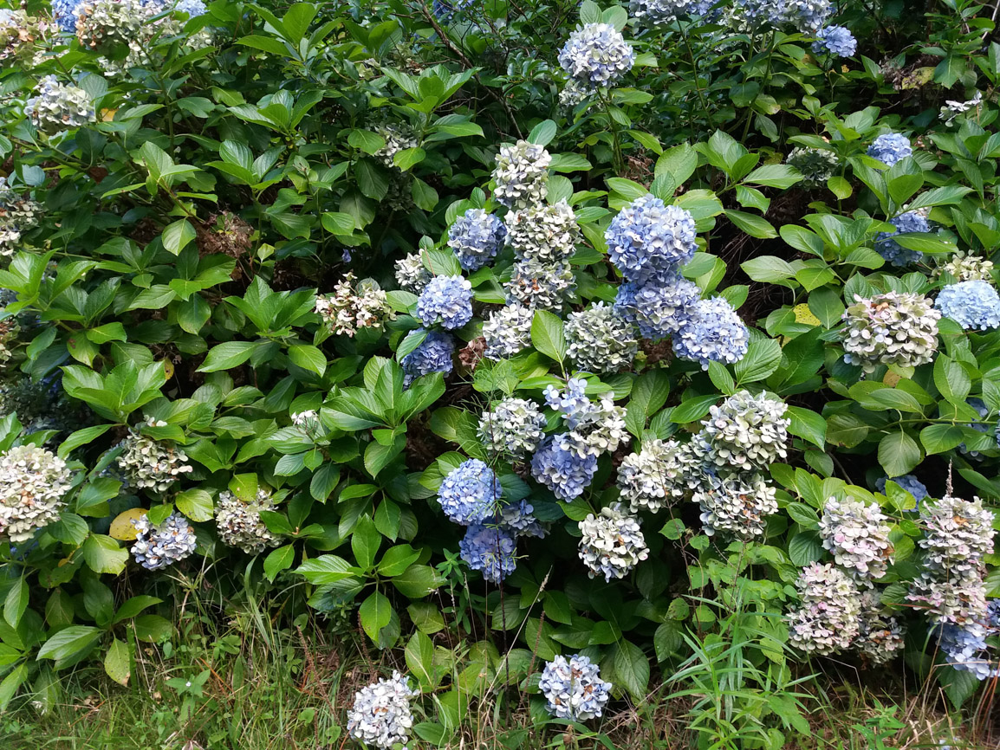

In [177]:
Image(filename='7.jpg')

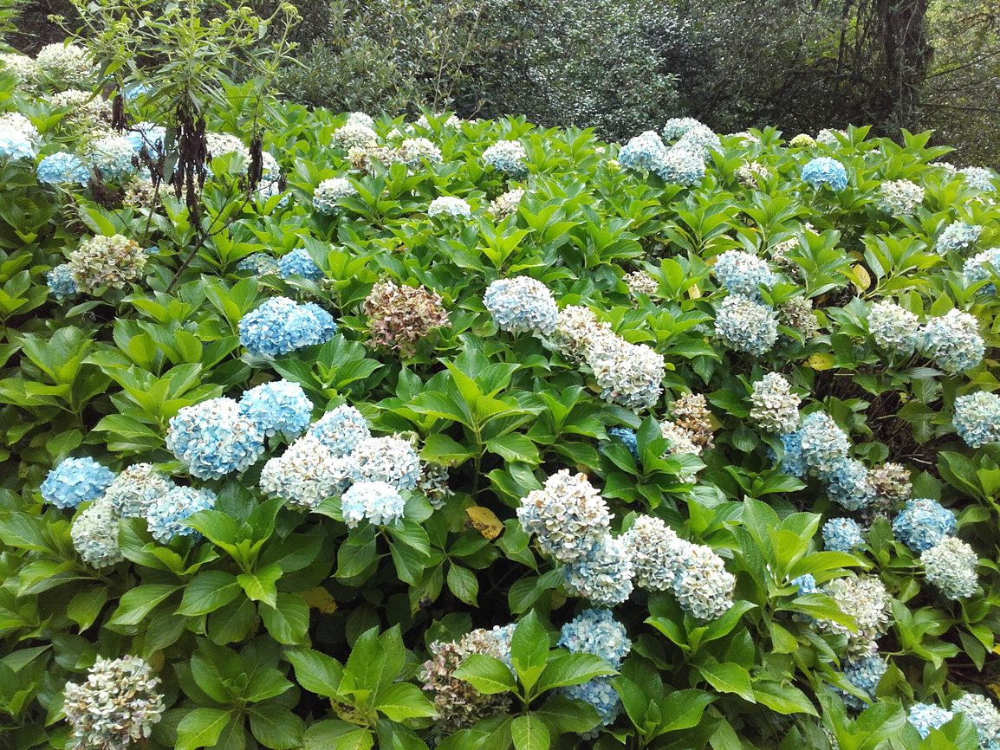

In [180]:
Image(filename='52.jpg')

Now let's look at 2 images that don't include invasive species.

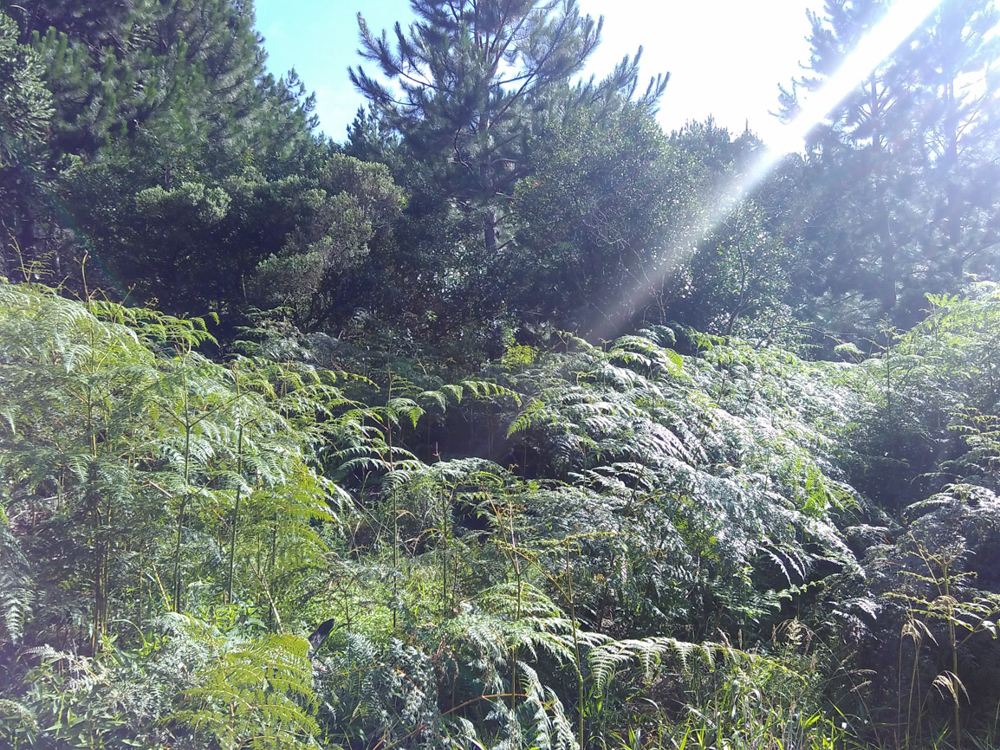

In [183]:
Image(filename='89.jpg')

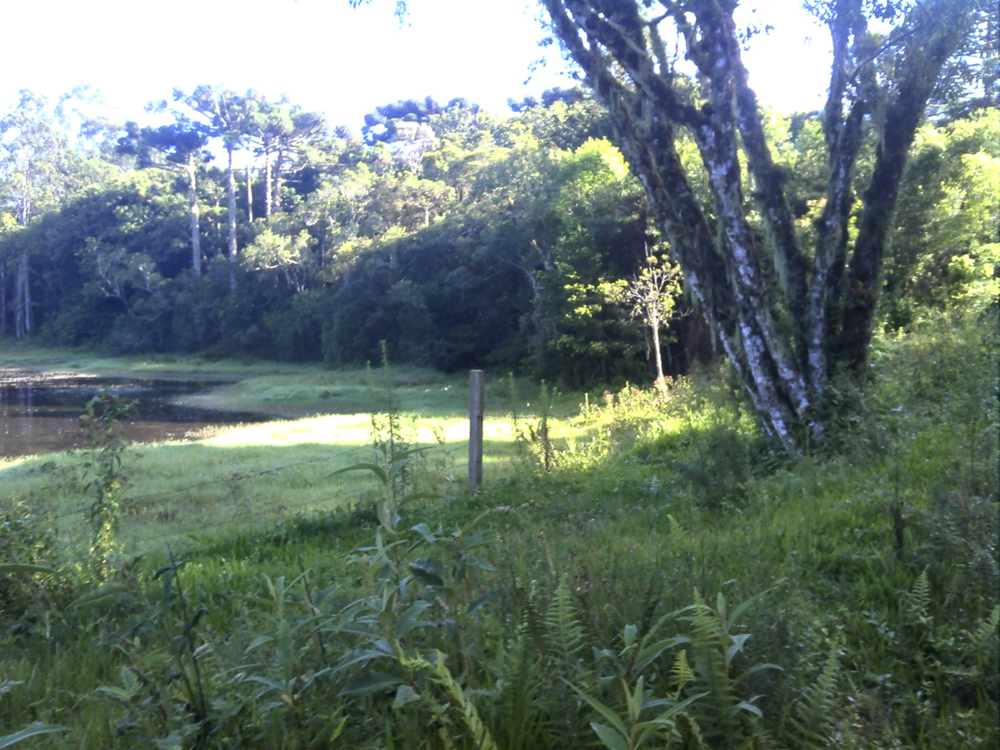

In [184]:
Image(filename='122.jpg')

## 4. Create First Model

Let's start with a simple convolutional neaural network from scratch and see what kind of accuracy we can achieve.

I received inspiration and help from this blog post for this part of the project: https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html

After much trial and error, I landed on the following simple model. The model has the following characteristics:

- A sequential model with an input shape of 256 by 256. This means that all of our images need to be resized to these dimensions. 
- The first convolutional layer contains 32 feature detectors, all of size 3x3. It uses the 'relu' activation function and a max-pooling layer 2x2 dimentions.
- The second layer is exactly the same as the first, giving the model further opportunity to distinguish relevant features from our data..
- The third layer uses twice as many feature maps (64), but is similar in every other way.
- After the first three layers the matricies are flattened into a long one dimentional vector that's used as the input layer for an artifical neaural network.
- One dense layer is used with an output demension of 128 and a 'relu' activation function. Dropout is applied to prevent overfitting.
- Then the final output layer is a dense layer with one output dimension, and an activation function of 'sigmoid' is applied. Sigmoid is used because it's a good choice for a binary classification problem.
- The model is compiled using an 'adam' optimizer. To be frank, I still have a basic understanding of what the adam optimizer is doing, but I've noticed that it's been especially effective in pactice. Adam differs from stochastic gradient descent, and leverages advantages from both the "Adaptive Gradient Algorithm" and "Root Mean Square Propagation". A Good Introduction can be found here: https://machinelearningmastery.com/adam-optimization-algorithm-for-deep-learning/
- The loss function is "binary cross entropy", because this is a binary classification problem.

Here is a photo of the activation functions used in the model:

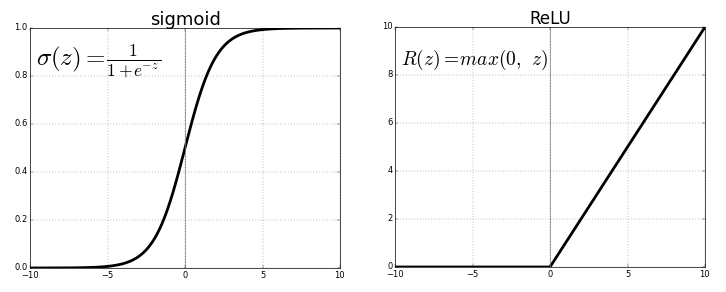

In [7]:
Image(filename = 'activation.jpg')

In [12]:
# Create Model
classifier = Sequential()
classifier.add(Convolution2D(32, 3, 3, input_shape=(256,256,3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))

classifier.add(Convolution2D(32, 3, 3, activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))

classifier.add(Convolution2D(64, 3, 3, activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))

classifier.add(Flatten()) 
classifier.add(Dense(output_dim = 128, activation= 'relu'))
classifier.add(Dropout(0.5))
classifier.add(Dense(output_dim = 1, activation= 'sigmoid'))


classifier.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(32, (3, 3), input_shape=(256, 256,..., activation="relu")`
  This is separate from the ipykernel package so we can avoid doing imports until
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(32, (3, 3), activation="relu")`
  
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), activation="relu")`
  if __name__ == '__main__':
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(activation="relu", units=128)`
  del sys.path[0]
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:15: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(activation="sigmoid", units=1)`
  from ipykernel import kerne

In [49]:
# Use Code below to load weights into model if kernal is stopped.
#classifier.load_weights('secondMod.h5')

## 5. FlowFromDirectory - Image Augmentation and Training the First Model.

The FlowFromDirectory function pulls photos from a local computer, perform specified image augmentation, and then feeds the image data into the model. Because of the image augmentation, a model will never receive the same data twice, which helps prevent the model from over-fitting to the training data. Let's take a look at how a few of these images are augmented with the perameters that I chose to use for the model. I wanted the augmentation to be conservative, because I didn't want to risk cropping out the invasive Hydrangea from images that are labeled "invasive". 

Found 2158 images belonging to 2 classes.


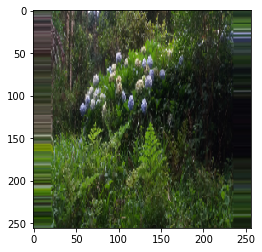

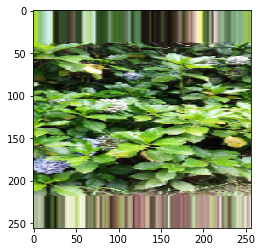

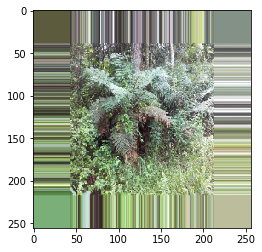

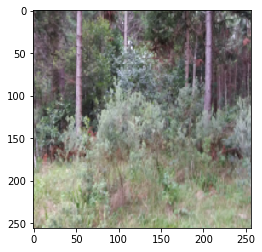

In [22]:
from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(
    rescale = 1./255, # rescaling pixel data to be between 0 and 1
    shear_range=0.2, # apply random transvections
    zoom_range=0.7, # random zooms to 70% of the image.
    horizontal_flip=True) # horizontal_flips

# Flow From Directory
training_set = train_datagen.flow_from_directory('/Users/sauce/Desktop/Data/train',
                                                target_size = (256, 256),
                                                batch_size = 32, 
                                                class_mode = 'binary')
# Plot 4 randomly selected images
x,y = training_set.next()
for i in range(0,4):
    image = x[i]
    plt.imshow(image)
    plt.show()

Let's train the model using this style of augmentation.

In [140]:
# Image Augmentation for the training Data.
train_datagen = ImageDataGenerator(
    rescale = 1./255, # rescaling pixel data to be between 0 and 1
    shear_range=0.2, # apply random transvections
    zoom_range=0.7, # random zooms to 70% of the image.
    horizontal_flip=True) # horizontal_flips

# Image resizing for the validation data - no need to augment validation images.
test_datagen = ImageDataGenerator(rescale=1./255) 

# Resizing train data.
training_set = train_datagen.flow_from_directory('/Users/sauce/Desktop/Data/train',
                                                target_size = (256, 256),
                                                batch_size = 32, 
                                                class_mode = 'binary') 

# Resizing validation data. 
test_set = test_datagen.flow_from_directory('/Users/sauce/Desktop/Data/validation',
                                           target_size= (256, 256),
                                           batch_size = 32,
                                           class_mode = 'binary')

# Fit model and begin Training. Using 50 epochs to train the model.
classifier.fit_generator(
    training_set,
    samples_per_epoch=2159, 
    nb_epoch=50, 
    validation_data = test_set, 
    nb_val_samples=137)
classifier.save_weights('secondMod.h5') # Save Weights

Found 2158 images belonging to 2 classes.
Found 137 images belonging to 2 classes.


/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:24: UserWarning: The semantics of the Keras 2 argument `steps_per_epoch` is not the same as the Keras 1 argument `samples_per_epoch`. `steps_per_epoch` is the number of batches to draw from the generator at each epoch. Basically steps_per_epoch = samples_per_epoch/batch_size. Similarly `nb_val_samples`->`validation_steps` and `val_samples`->`steps` arguments have changed. Update your method calls accordingly.
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:24: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<keras.pre..., validation_data=<keras.pre..., steps_per_epoch=67, epochs=50, validation_steps=137)`


Epoch 1/50
67/67 [==============================] - 397s 6s/step - loss: 0.6481 - acc: 0.6454 - val_loss: 0.4312 - val_acc: 0.7877
Epoch 2/50
67/67 [==============================] - 385s 6s/step - loss: 0.4928 - acc: 0.7526 - val_loss: 0.3640 - val_acc: 0.8392
Epoch 3/50
67/67 [==============================] - 405s 6s/step - loss: 0.4602 - acc: 0.7886 - val_loss: 0.4004 - val_acc: 0.8172
Epoch 4/50
67/67 [==============================] - 379s 6s/step - loss: 0.4215 - acc: 0.8031 - val_loss: 0.3043 - val_acc: 0.9051
Epoch 5/50
67/67 [==============================] - 396s 6s/step - loss: 0.3834 - acc: 0.8408 - val_loss: 0.3368 - val_acc: 0.8172
Epoch 6/50
67/67 [==============================] - 406s 6s/step - loss: 0.3764 - acc: 0.8364 - val_loss: 0.2985 - val_acc: 0.8762
Epoch 7/50
67/67 [==============================] - 391s 6s/step - loss: 0.3445 - acc: 0.8565 - val_loss: 0.2787 - val_acc: 0.8685
Epoch 8/50
67/67 [==============================] - 413s 6s/step - loss: 0.3338 - a

As seen above, the model yielded good results. The accuracy ended up being about 95%. The validation accuracy ended up being as good as 96%, and the loss reached a minimum of .1339.

## 6. VGG16 Pre-Trained Model

In my next attempt, I decided to harness the power of a pre-trained model offered by keras. The VGG16 model has been trained on massive datasets with giant GPUs that we mortals have no access to. Even though the model wasn't trained on images of plants, these models are over-powered in detecting edges between objects. I received help and inspiration for this part fo the project from https://www.kaggle.com/fujisan/use-keras-pre-trained-vgg16-acc-98

In [125]:
# Load VGG16 model with pre-trained weights from imagenet and an input shape of 256x256.
model = applications.VGG16(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

In [126]:
# Change model to Sequential.
add_model = Sequential()
# Flatten outputs.
add_model.add(Flatten(input_shape=model.output_shape[1:]))
# Add dense layer with output shape of 256.
add_model.add(Dense(256, activation='relu'))
# Add another dense layer with output shape of 1 and use a sigmoid activation function.
add_model.add(Dense(1, activation='sigmoid'))

For this model I decided to use stochastic gradient decent to update the weights. I used an especially small learning rate of .0001, and a momentum of .90. I saw these perameters yield strong results in other kaggle kernals.

In [127]:
# Compile model
model = Model(inputs=model.input, outputs=add_model(model.output))
model.compile(loss='binary_crossentropy', optimizer=optimizers.SGD(lr=1e-4, momentum=0.9),
              metrics=['accuracy'])

In [128]:
# Use code below if you need to reload model weights.
# model.load_weights('sixthMod.h5')

In [8]:
# Slightly modified image augmentation parameters.
train_datagen = ImageDataGenerator(
    rescale = 1./255, 
    width_shift_range=0.1, 
    height_shift_range=0.1, 
    horizontal_flip=True)

test_datagen = ImageDataGenerator(rescale=1./255) 

training_set = train_datagen.flow_from_directory('/Users/sauce/Desktop/Data/train',
                                                target_size = (256, 256),
                                                batch_size = 32, 
                                                class_mode = 'binary')
test_set = test_datagen.flow_from_directory('/Users/sauce/Desktop/Data/validation',
                                           target_size= (256, 256),
                                           batch_size = 32,
                                           class_mode = 'binary')

# Only ran 20 epochs because of how time consuming this model is to train.
History = model.fit_generator(
    training_set,
    samples_per_epoch=2159, 
    nb_epoch=20, 
    validation_data = test_set, 
    nb_val_samples=137) 

model.save_weights('sixthMod.h5')

Found 2158 images belonging to 2 classes.
Found 137 images belonging to 2 classes.


/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:24: UserWarning: The semantics of the Keras 2 argument `steps_per_epoch` is not the same as the Keras 1 argument `samples_per_epoch`. `steps_per_epoch` is the number of batches to draw from the generator at each epoch. Basically steps_per_epoch = samples_per_epoch/batch_size. Similarly `nb_val_samples`->`validation_steps` and `val_samples`->`steps` arguments have changed. Update your method calls accordingly.
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:24: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<keras.pre..., validation_data=<keras.pre..., steps_per_epoch=67, epochs=20, validation_steps=137)`


Epoch 1/20
67/67 [==============================] - 7213s 108s/step - loss: 0.4788 - acc: 0.7519 - val_loss: 0.3264 - val_acc: 0.8387
Epoch 2/20
67/67 [==============================] - 7564s 113s/step - loss: 0.2435 - acc: 0.8961 - val_loss: 0.2634 - val_acc: 0.8977
Epoch 3/20
67/67 [==============================] - 7920s 118s/step - loss: 0.2013 - acc: 0.9198 - val_loss: 0.1714 - val_acc: 0.9208
Epoch 4/20
67/67 [==============================] - 6442s 96s/step - loss: 0.1607 - acc: 0.9419 - val_loss: 0.1670 - val_acc: 0.9280
Epoch 5/20
67/67 [==============================] - 6432s 96s/step - loss: 0.1470 - acc: 0.9494 - val_loss: 0.1643 - val_acc: 0.9195
Epoch 6/20
67/67 [==============================] - 6412s 96s/step - loss: 0.1456 - acc: 0.9482 - val_loss: 0.1508 - val_acc: 0.9341
Epoch 7/20
67/67 [==============================] - 6417s 96s/step - loss: 0.1180 - acc: 0.9574 - val_loss: 0.1751 - val_acc: 0.9267
Epoch 8/20
67/67 [==============================] - 6420s 96s/step

As shown above, this model out-performs my first attempt. The loss function decreased all the way down to less than .05. The accuracy stabalized at about 98%, and the validation accuracy finished at about 95%. This model took about 30 hours to train on my CPU, which is very expensive. The loss continued to decrease with each subsequent epoch, so if I had a powerful GPU resource, I would keep training it with about 30 more epochs. Below is a plot of the training.

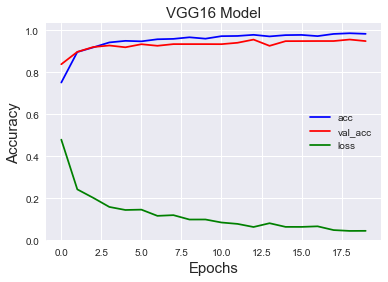

In [194]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.plot(History.history['acc'],'b', label='acc') 
plt.plot(History.history['val_acc'],'r', label='val_acc')
plt.plot(History.history['loss'], 'g', label = 'loss')
plt.ylabel('Accuracy', fontsize = 15)
plt.xlabel('Epochs', fontsize = 15)
plt.title('VGG16 Model', fontsize = 15)
plt.legend()
plt.show()

## 7. Transfer Learning with ResNet50

With help and inspiration from https://www.kaggle.com/dansbecker/transfer-learning/notebook, I tried transfer learning with the ResNet50 model offered by Keras.

In [81]:
# BottleNeck features downloaded from https://www.kaggle.com/dansbecker/transfer-learning/data
resnet_weights_path = '/Users/sauce/Desktop/Data/train/resnet50.h5'

my_new_model = Sequential() # Initialize Sequential Model
# Add ResNet50 Model with downloaded weights.
my_new_model.add(ResNet50(include_top=False, pooling='avg', weights=resnet_weights_path))
my_new_model.add(Dense(128, activation= 'relu')) # Add a Dense Layer with Relu activation function.
my_new_model.add(Dense(1, activation= 'sigmoid')) # Add output layer with sigmoid activation function.


# Don't train ResNet model. 
# We keep the ResNet weights as they are, and only update the weights for the layers that we added.
my_new_model.layers[0].trainable = False

In [82]:
# Compile model with stochastic gradient decent optimizer.
my_new_model.compile(optimizer='sgd', loss='binary_crossentropy', metrics=['accuracy'])

In [88]:
# Check out model structure.
my_new_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet50 (Model)             (None, 2048)              23587712  
_________________________________________________________________
dense_9 (Dense)              (None, 128)               262272    
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 129       
Total params: 23,850,113
Trainable params: 262,401
Non-trainable params: 23,587,712
_________________________________________________________________


In [84]:
# Image Augmentation.
train_datagen = ImageDataGenerator(
    rescale = 1./255, 
    width_shift_range=0.1, 
    height_shift_range=0.1, 
    horizontal_flip=True)

test_datagen = ImageDataGenerator(rescale=1./255) 

training_set = train_datagen.flow_from_directory('/Users/sauce/Desktop/Data/train',
                                                target_size = (256, 256),
                                                batch_size = 32, 
                                                class_mode = 'binary')
test_set = test_datagen.flow_from_directory('/Users/sauce/Desktop/Data/validation',
                                           target_size= (256, 256),
                                           batch_size = 32,
                                           class_mode = 'binary')

# 10 epochs, will continue training if model is successful.
History2 = my_new_model.fit_generator(
    training_set,
    steps_per_epoch=200, 
    epochs=10, 
    validation_data = test_set, 
    validation_steps=137) 

# Save weights.
model.save_weights('resnet.h5')

Found 2158 images belonging to 2 classes.
Found 137 images belonging to 2 classes.
Epoch 1/10
200/200 [==============================]200/200 [==============================] - 3894s 19s/step - loss: 0.2307 - acc: 0.9091 - val_loss: 0.6560 - val_acc: 0.6859

Epoch 2/10
200/200 [==============================]200/200 [==============================] - 3421s 17s/step - loss: 0.2072 - acc: 0.9149 - val_loss: 0.6887 - val_acc: 0.6139

Epoch 3/10
200/200 [==============================]200/200 [==============================] - 3887s 19s/step - loss: 0.1875 - acc: 0.9236 - val_loss: 0.6828 - val_acc: 0.6348

Epoch 4/10
200/200 [==============================]200/200 [==============================] - 3497s 17s/step - loss: 0.1744 - acc: 0.9286 - val_loss: 0.6909 - val_acc: 0.6056

Epoch 5/10
200/200 [==============================]200/200 [==============================] - 3419s 17s/step - loss: 0.1587 - acc: 0.9409 - val_loss: 0.7030 - val_acc: 0.5626

Epoch 6/10
200/200 [=================

FailedPreconditionError: Attempting to use uninitialized value dense_5/bias
	 [[Node: _retval_dense_5/bias_0_0 = _Retval[T=DT_FLOAT, index=0, _device="/job:localhost/replica:0/task:0/device:CPU:0"](dense_5/bias)]]

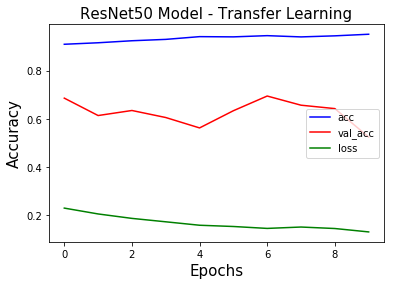

In [85]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.plot(History2.history['acc'],'b', label='acc') 
plt.plot(History2.history['val_acc'],'r', label='val_acc')
plt.plot(History2.history['loss'], 'g', label = 'loss')
plt.ylabel('Accuracy', fontsize = 15)
plt.xlabel('Epochs', fontsize = 15)
plt.title('ResNet50 Model - Transfer Learning', fontsize = 15)
plt.legend()
plt.show()

This model seemed to suffer from a considerable amount of overfitting, and it performed less effectively than the first two models that I created. While the training accuracy reached about 95%, the model didn't perform well on the validation data.

## 8. Make Test Data Predictions with Most Effective Model

The most effective model that I created was clearly the VGG16 model. It enjoyed a training accuray of about 98% and a vlaidation accuracy of about 95%. Its loss decreased to less than .05. I decided to make my test set predictions with this model. The unlabled dataset used for making predictions includes 1531 images.

In [54]:
# Rescale images, no ned to use data augmentation for testing data.
test_datagen = ImageDataGenerator(rescale=1./255)

# Flow from Directory. Point to directory where test images are located.
test_generator = test_datagen.flow_from_directory(
    '/Users/sauce/Desktop/Data/test',
    target_size = (256, 256),
    batch_size = 1,
    class_mode = 'binary',
    shuffle = False)

Found 1531 images belonging to 1 classes.


In [12]:
# Make predictions.
predictions2 = model.predict_generator(test_generator,
                                      steps = 1531)

In [15]:
# Change predictions into a dataframe.
predictions_df2 = pd.DataFrame(predictions2, columns = ['invasive'])

In [16]:
# Show head of dataframe
predictions_df2.head()

,invasive
0,0.986384
1,0.000331
2,0.024196
3,0.065561
4,0.000129


Kaggle requires the file used for submission be in a specific format. Unfortunetally "FlowFromDirectory" doesn't perserve the order of the photos in the test data file, so some modifications need to be made. I used helpful code from https://www.kaggle.com/ievgenvp/keras-flow-from-directory-on-python to make these modifications.

In [17]:
# Create Teste File Names
test_files_names = test_generator.filenames

# Insert file names into predictions dataframe under column header "names".
predictions_df2.insert(0, "name", test_files_names)

# Strip uneccessary text from "names" column.
predictions_df2['name'] = predictions_df2['name'].map(lambda x: x.lstrip('Test/').rstrip('.jpg'))

# Change data type to numeric.
predictions_df2['name'] = pd.to_numeric(predictions_df2['name'], errors = 'coerce')

# Sort values into dataframe to return to the proper order.
predictions_df2.sort_values('name', inplace = True)

# Create .CSV file of predictions.
predictions_df2.to_csv('test_pred5.csv', index = False)

Below is a screenshot of my predictions file in excel. The "Name" column represents the each photo in the test data set. The "invasive" column represents the model's prediction for how likely it is for each respective photo to contain invasive Hydrangea. Propabilities over 0.5 are classified as invasive.

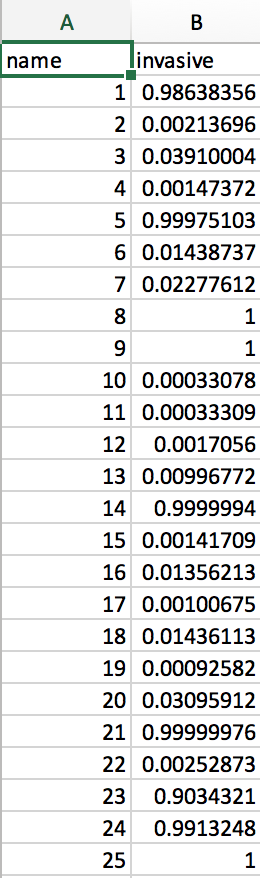

In [94]:
Image(filename='pred.png')

From Kaggle - "Submissions are evaluated on area under the ROC curve between the predicted probability and the observed target." Below is my proof of submission.

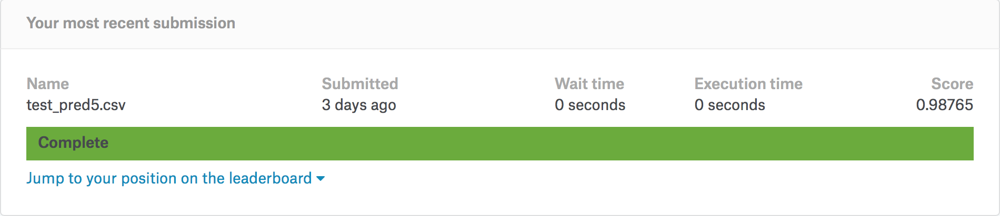

In [95]:
Image(filename='sub.png')

My submission yielded an ROC score of just under .99. This landed me in the top 25% of all submissions on Kaggle's public leaderboard for this competition. Looking through various kernals, it was clear that many of the folks who recieved a score better than .98765 were using a GPU, which saves time when training models. Many were also using more advanced methods of transfer learning and ensemble learning. 

## 9. Test Models on My Own Photos

I've placed 7 new images into a folder on my local machine. Two of the photos are images of Hydrangea taken from Google Images, which the models should have no problem classifying. The other 5 are images are photos I've taken on various hikes in Colorado and Oregon. The photos don't much resemble the images of the Brazilian National Park that we used to train our model, so it might have trouble classifying the new images. None of the photos that I chose contain Hydrangia, but some do contain colorful flowers. It will be interesting to see how the model performs on these new images. I'll display the images and their predictions below.

In [130]:
# Rescale My Images
test_datagen2 = ImageDataGenerator(rescale=1./255)

# Flow From Directory
test_generator = test_datagen.flow_from_directory(
    '/Users/sauce/Desktop/My_plants',
    target_size = (256, 256),
    batch_size = 1,
    class_mode = 'binary',
    shuffle = False)

Found 7 images belonging to 1 classes.


In [134]:
# Make Predictions with the VGG16 model
Vgg16_my_photos = model.predict_generator(test_generator,
                                      steps = 7)
Vgg16_my_photos_df = pd.DataFrame(Vgg16_my_photos, columns = ['invasive'])

In [135]:
# Make Predictions with my first CNN model.
MyCNN_my_photos = classifier.predict_generator(test_generator,
                                      steps = 7)
MyCNN_my_photos_df = pd.DataFrame(MyCNN_my_photos, columns = ['invasive'])

In [137]:
Vgg16_my_photos_df

,invasive
0,1.000000
1,1.000000
2,0.516348
3,0.205918
4,0.019028
5,0.023552
6,0.625501


In [138]:
MyCNN_my_photos_df

,invasive
0,1.000000
1,1.000000
2,1.000000
3,0.027161
4,0.035083
5,0.000628
6,0.526449


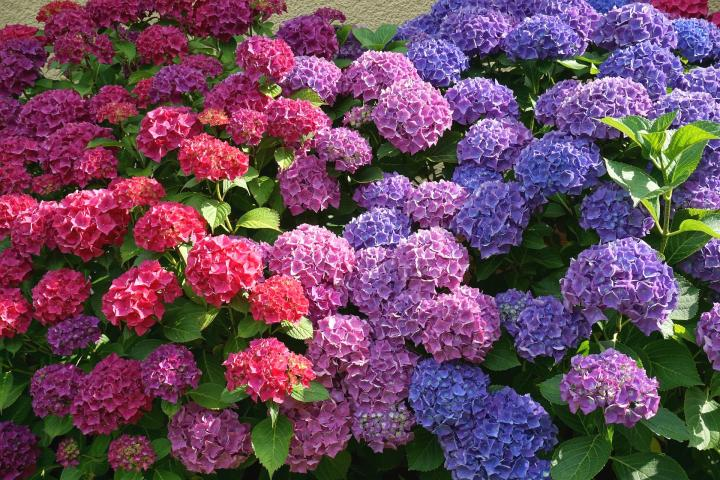

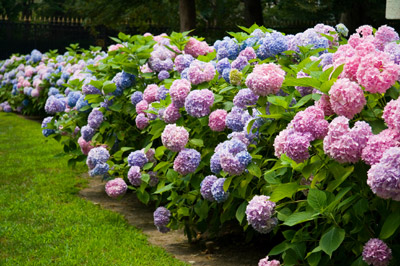

In [142]:
# Hydrangea Photos
x = Image(filename='hy1.jpg') 
y = Image(filename='hy2.jpg') 
display(x, y)

The first two photos shown above are Photos of Hydrangia taken from Google Images. Both models predicted that there is a 100% probability that these photos contain invasive Hydrangea, which is encouraging.

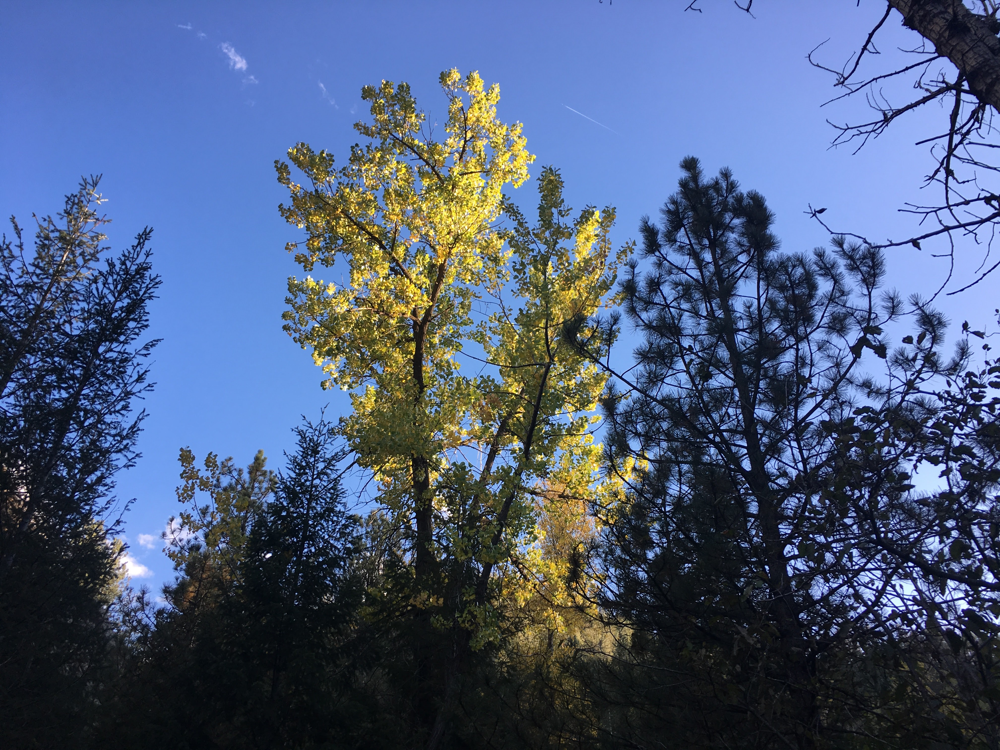

In [144]:
x = Image(filename='pl1.jpg')
display(x)

Both models incorrectly predicted that this photo contains invasive Hydrangea. My CNN model gave it a 100% chance, and the VGG16 model gave it a 51% chance. In this case, the VGG16 model was more accurate.

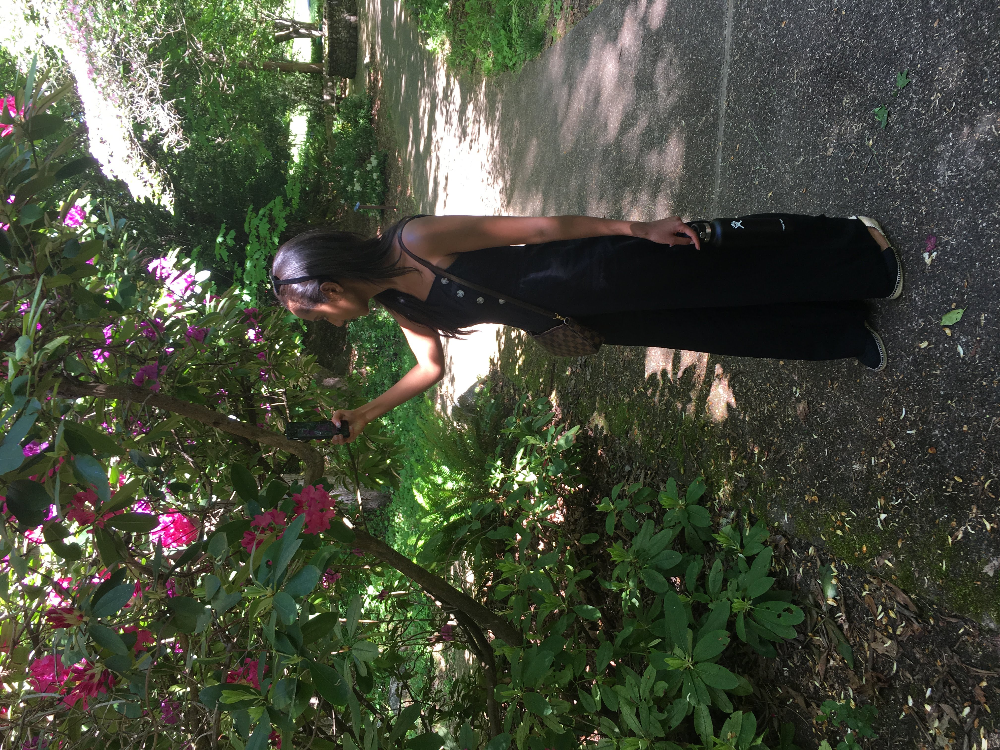

In [153]:
Image(filename='pl2.jpg')

I thought this photo would trick the models because it contains colorful flowers, but both models correctly classified this as non-invasive. I was also worried that my beautiful girlfriend might secretly be an invasive organism - it's nice to know that both models don't think she is.

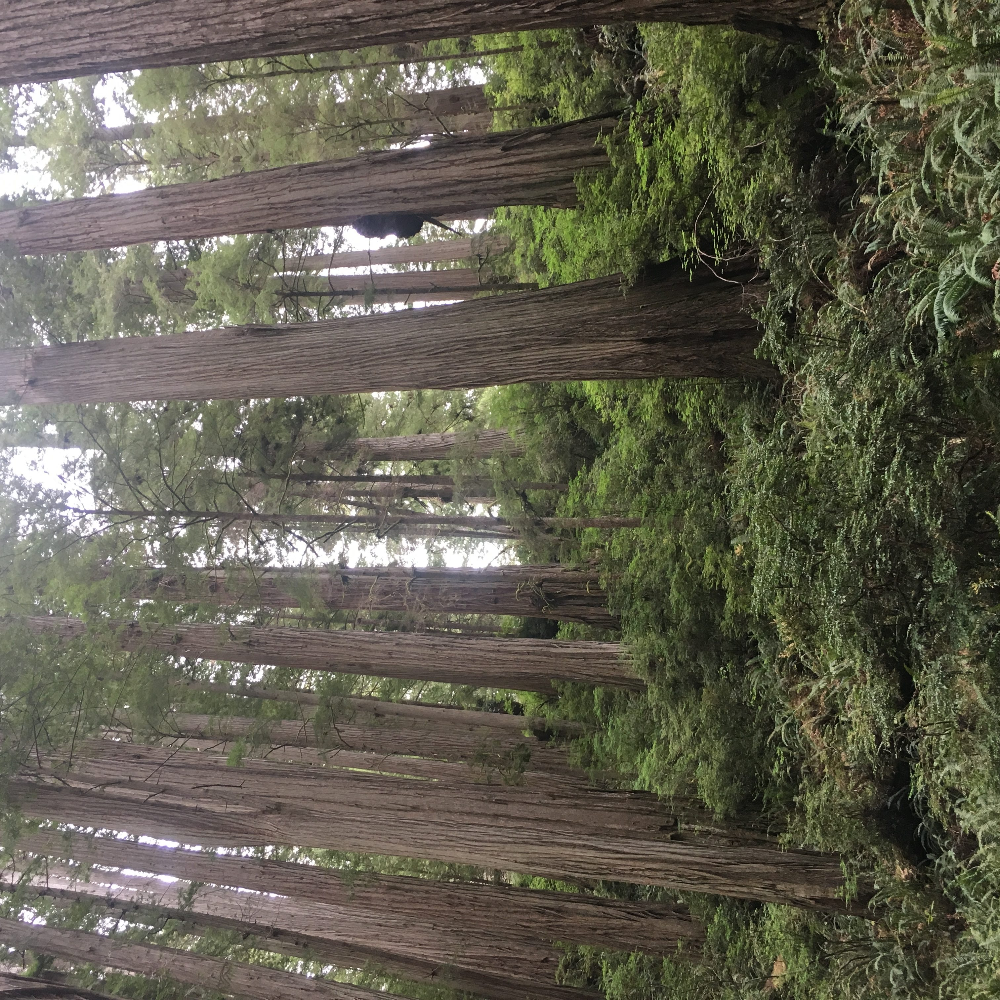

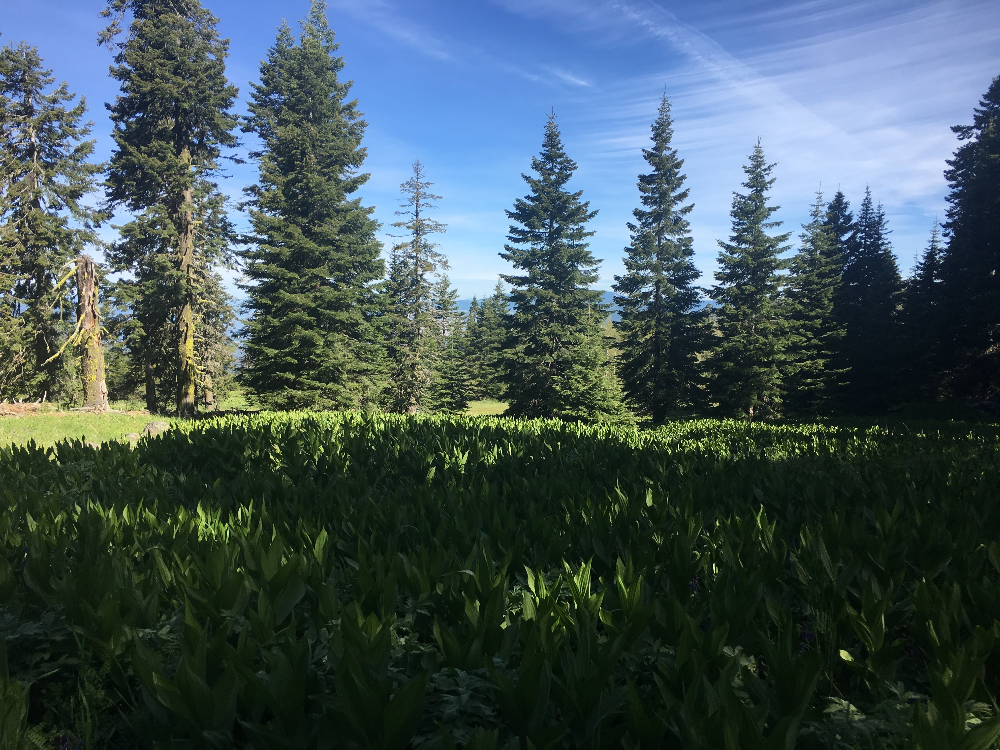

In [154]:
x = Image(filename='pl3.jpg') 
y = Image(filename='pl4.jpg') 
display(x, y)

Both models correctly gave these photos a less than 5% chance of invasive species.

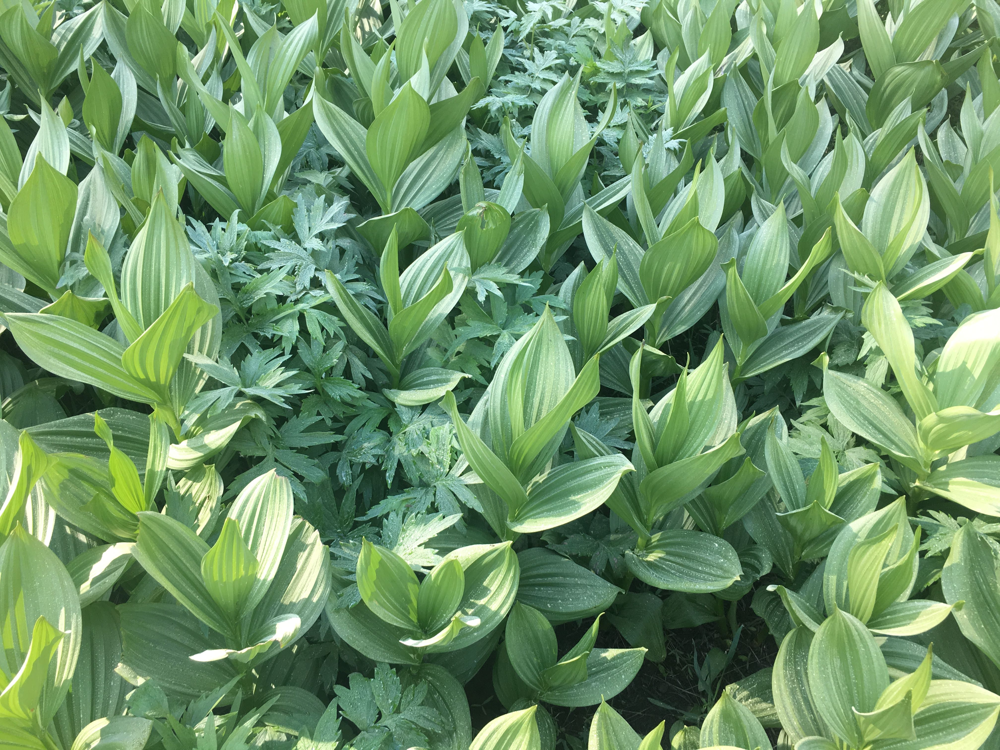

In [156]:
Image(filename='pl5.jpg') 

This photo tripped up both models - both incorrectly classifed this photo as including invasive Hydrangea. The CNN model gave a more active probability than the VGG16 model.

## 10. Conclusion and Next Steps

Some important take-away from this project are the following:

- Pre-trained models are incredibly powerful, and it would be foolish to not harness their power.

- Flow from directory is a very useful function provided by Keras, but the data orgonization process required to use it is rather time consuming and tedious.

- It's expensive to run complex and effective models on a CPU.

- Image augmentation is a very valuable tool to prevent overfitting, especially when working with limited image data.

- It's integral to save weights and models after training.


A few ideas for next steps to improve my models:

- Try different learning rates for each model.


- Run pretrained VGG16 model for more epochs on a GPU service. The loss was still decreasing when the model was done training, but I was too impatient to wait 30 more hours to train for 20 more epochs.

- Experiment with other pre-trained models and more advanced transfer learning methods.

- Experiment with various data augmentation methods/parameters.

- Experiment with ensemble learning or model stacking.